In [2]:
# Cell 1: Import Required Libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, KFold, cross_val_score
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import confusion_matrix, classification_report, roc_curve, roc_auc_score
import lightgbm as lgb
import shap
from datetime import datetime
from imblearn.over_sampling import SMOTE
from sklearn.ensemble import IsolationForest

In [4]:

data = pd.read_csv('C:\\Users\\vishn\\OneDrive\\Desktop\\IITkgp Astroid project\\dataset.csv')

In [5]:
# 3.1 Data Inspection
print(data.info())
print(data.describe())

# Identify features with missing values
missing_values = data.isnull().sum()
print("Missing Values:\n", missing_values[missing_values > 0])

# Identify numerical and categorical features
numerical_features = data.select_dtypes(include=[np.number]).columns.tolist()
categorical_features = data.select_dtypes(include=[object]).columns.tolist()

# Impute missing values
data[numerical_features] = data[numerical_features].fillna(data[numerical_features].mean())
data[categorical_features] = data[categorical_features].fillna(data[categorical_features].mode().iloc[0])


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4534 entries, 0 to 4533
Data columns (total 24 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Name                          4534 non-null   int64  
 1   Epoch Date Close Approach     3280 non-null   float64
 2   Relative Velocity km per sec  3184 non-null   object 
 3   Relative Velocity km per hr   3033 non-null   float64
 4   Miles per hour                3668 non-null   float64
 5   Miss Dist.(Astronomical)      3933 non-null   float64
 6   Miss Dist.(lunar)             3417 non-null   float64
 7   Miss Dist.(kilometers)        3166 non-null   float64
 8   Miss Dist.(miles)             3882 non-null   float64
 9   Jupiter Tisserand Invariant   2802 non-null   float64
 10  Epoch Osculation              3007 non-null   float64
 11  Semi Major Axis               3346 non-null   float64
 12  Asc Node Longitude            3438 non-null   float64
 13  Per

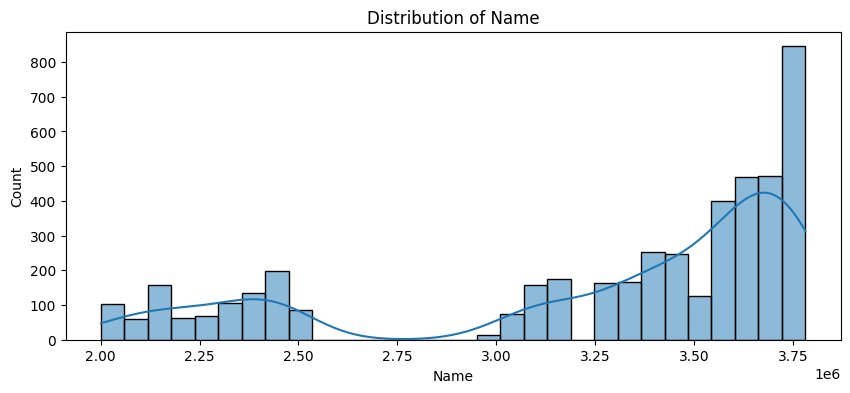

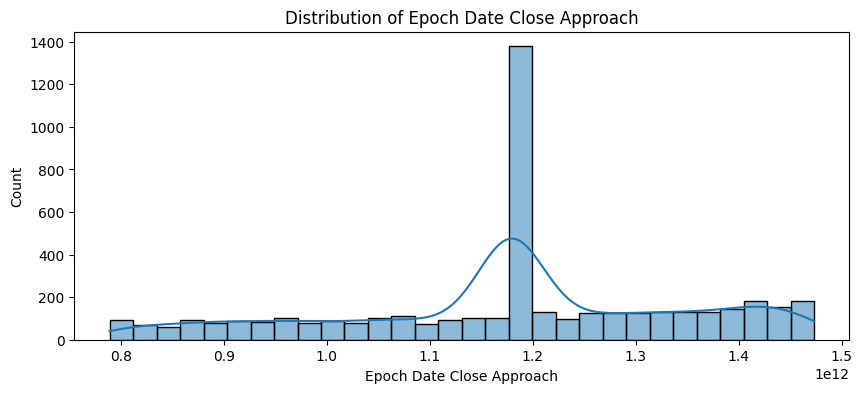

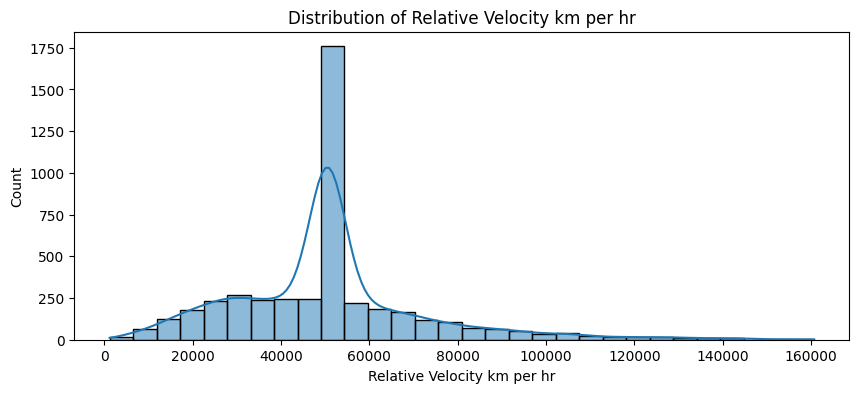

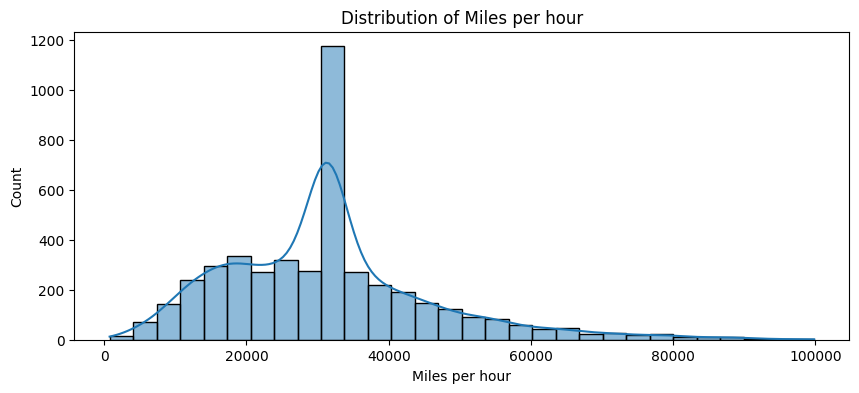

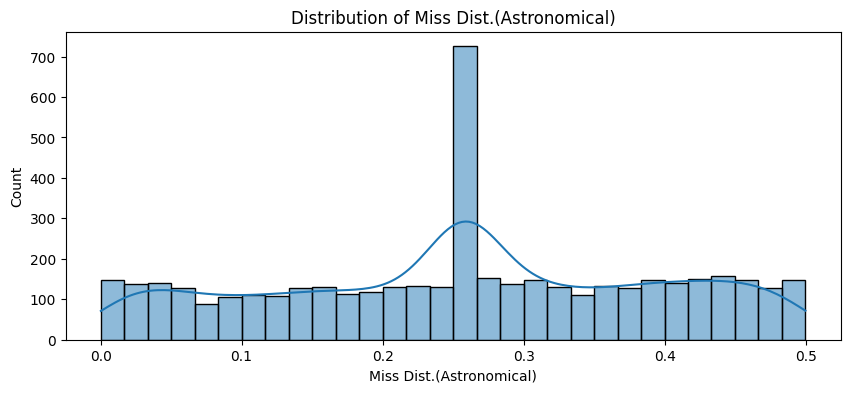

...

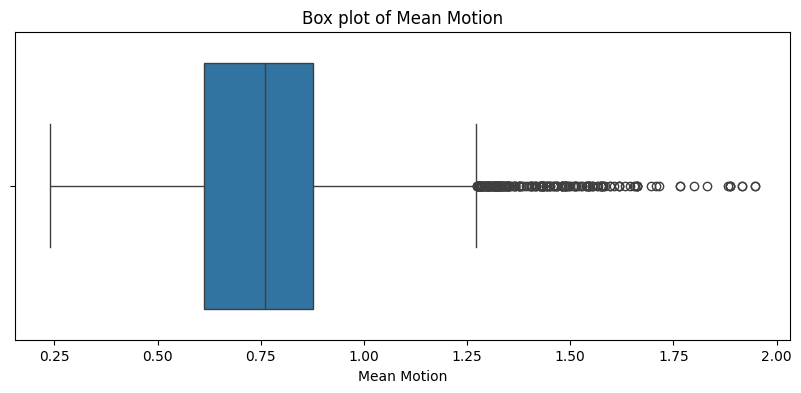

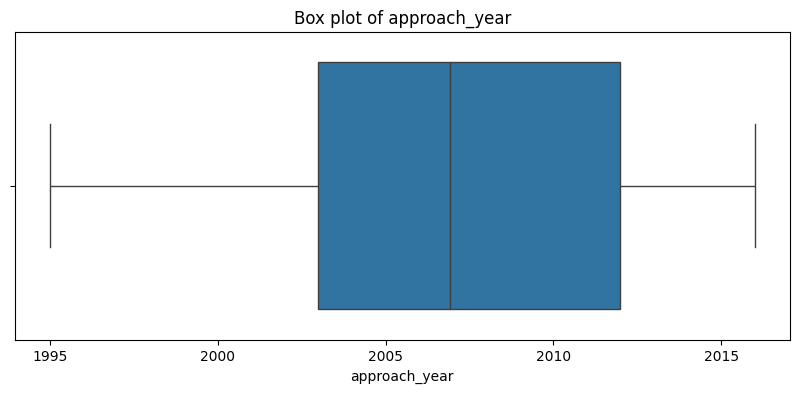

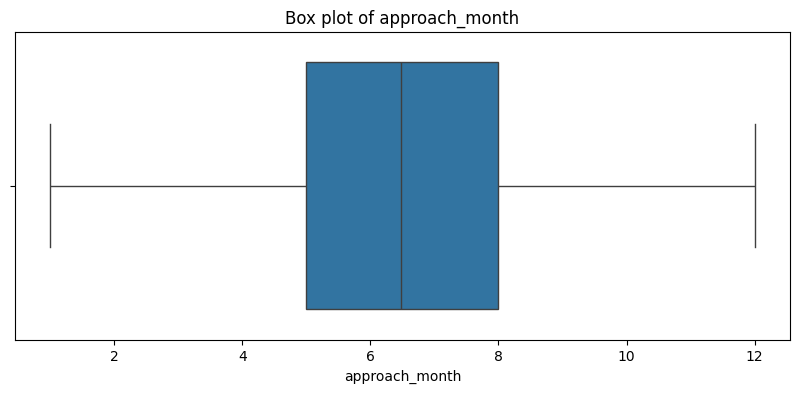

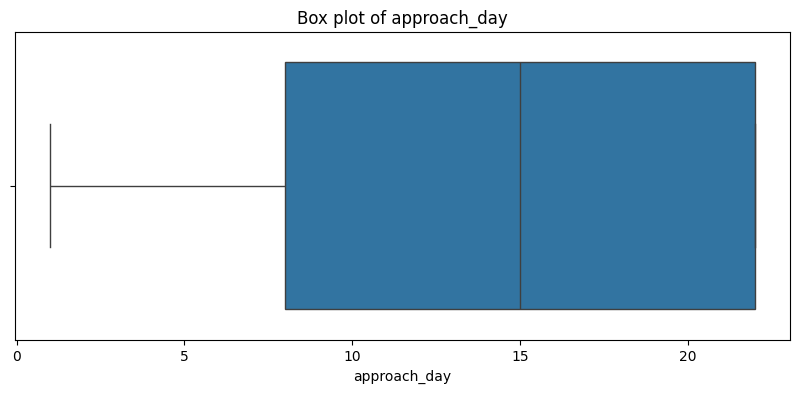

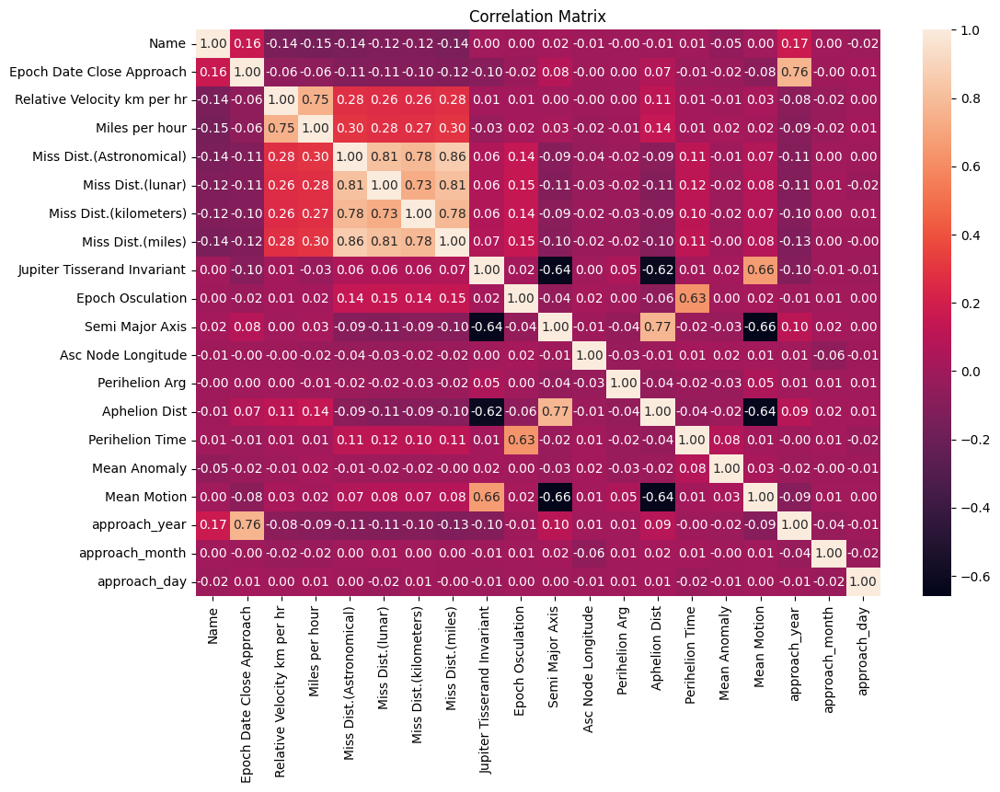

In [6]:
# Plot distribution of numerical features
for feature in numerical_features:
    plt.figure(figsize=(10, 4))
    sns.histplot(data[feature], bins=30, kde=True)
    plt.title(f'Distribution of {feature}')
    plt.show()

# Identify outliers using box plots
for feature in numerical_features:
    plt.figure(figsize=(10, 4))
    sns.boxplot(x=data[feature])
    plt.title(f'Box plot of {feature}')
    plt.show()

# Correlation matrix
plt.figure(figsize=(12, 8))
correlation_matrix = data[numerical_features].corr()
sns.heatmap(correlation_matrix, annot=True, fmt='.2f')
plt.title('Correlation Matrix')
plt.show()

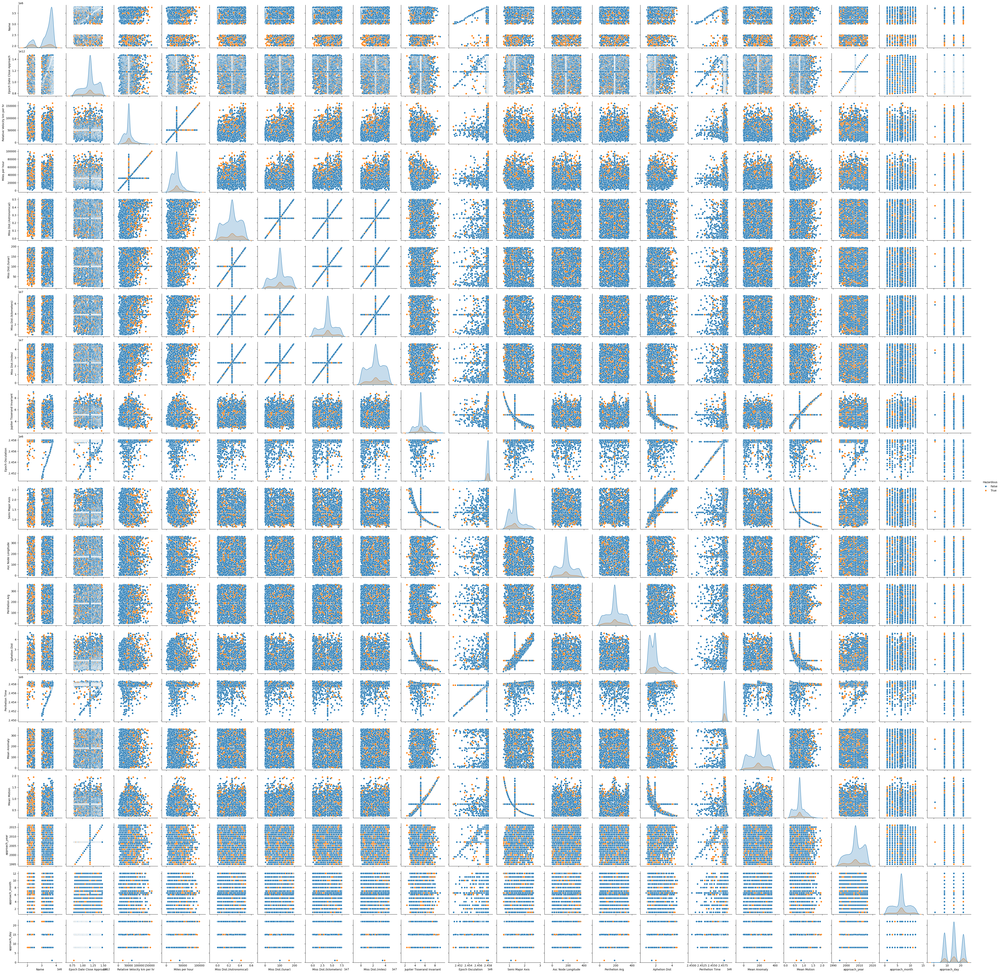

In [7]:
# Pairplot using Seaborn
sns.pairplot(data[numerical_features + ['Hazardous']], hue='Hazardous')
plt.show()


In [9]:
from sklearn.preprocessing import LabelEncoder

# Identify categorical features 
categorical_features = ['Relative Velocity km per sec', 'Orbital Period', 'Orbit Uncertainity']  

# Encode categorical features
label_encoders = {}
for feature in categorical_features:
    le = LabelEncoder()
    data[feature] = le.fit_transform(data[feature])
    label_encoders[feature] = le  # Store the encoder if you need to inverse transform later


In [10]:
# Check for class imbalance
print(data['Hazardous'].value_counts())

## Use SMOTE to handle class imbalance
X = data.drop(columns='Hazardous')
y = data['Hazardous']
smote = SMOTE()
X_resampled, y_resampled = smote.fit_resample(X, y)

Hazardous
False    3798
True      736
Name: count, dtype: int64


In [16]:
# Assuming Cell 7: Feature Engineering

# Parse the approach date columns and Epoch Date Close Approach
# Combine year, month, and day into a single datetime column
data['approach_date'] = pd.to_datetime(
    data['approach_year'].astype(str) + '-' +
    data['approach_month'].astype(str) + '-' +
    data['approach_day'].astype(str),
    errors='coerce'
)

# Ensure Epoch Date Close Approach is in datetime format
data['Epoch Date Close Approach'] = pd.to_datetime(data['Epoch Date Close Approach'], errors='coerce')

# Now calculate 'Time Until Approach'
# Check for non-null values before performing the subtraction
data['Time Until Approach'] = (data['Epoch Date Close Approach'] - pd.Timestamp.now()).dt.days

# Calculate additional features as before
data['Miss Distance Ratio'] = data['Miss Dist.(kilometers)'] / data['Semi Major Axis']
data['Eccentricity'] = np.sqrt(1 - (data['Semi Major Axis']**2 / data['Aphelion Dist']**2))
data['Average Orbital Velocity'] = (2 * np.pi * data['Semi Major Axis']) / data['Orbital Period']
data['Heliocentric Distance'] = data['Semi Major Axis'] * (1 - data['Eccentricity'])
data['Escape Velocity'] = np.sqrt(2 * 398600 / data['Semi Major Axis'])  # Assuming GM = 398600 km^3/s^2
data['Specific Orbital Energy'] = -398600 / (2 * data['Semi Major Axis'])
data['Specific Angular Momentum'] = np.sqrt(398600 * data['Semi Major Axis'] * (1 - data['Eccentricity']**2))

# Drop original date columns if no longer needed
data.drop(columns=['approach_year', 'approach_month', 'approach_day'], inplace=True)


C:\Users\vishn\AppData\Local\Temp\ipykernel_14904\2903118883.py:5: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  data['approach_date'] = pd.to_datetime(
C:\Users\vishn\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\pandas\core\arraylike.py:399: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [20]:
# Cell 8: Handling Binned Values
# Assuming 'Relative Velocity km per hr' has been dropped, working with 'Relative Velocity km per sec'
# Create binned categories for Relative Velocity km per sec

# Define bins and labels for Relative Velocity
data['Speed Category'] = pd.cut(data['Relative Velocity km per sec'],
                                bins=[0, 5.56, 13.89, 22.22, 27.78],  # these represent various speeds in km/sec
                                labels=[0, 1, 2, 3])

# If there are other features you need to one-hot encode, for example, non-ordinal categorical features
# Here 'your_non_ordinal_feature' represents any other feature you may have that needs one-hot encoding
# Adjust based on your actual categorical features
data = pd.get_dummies(data, columns=['Name', 'Relative Velocity km per sec', 'Orbital Period'], drop_first=True)  

# Display the first few rows to confirm transformations
print(data.head())


      Epoch Date Close Approach  Relative Velocity km per hr  Miles per hour  \
0 1970-01-01 00:13:08.947200000                 22017.003799    13680.509944   
1 1970-01-01 00:19:38.921406951                 65210.346095    40519.173105   
2 1970-01-01 00:13:09.552000000                 27326.560182    16979.661798   
3 1970-01-01 00:13:10.156800000                 40225.948191    24994.839864   
4 1970-01-01 00:13:10.156800000                 35426.991794    31312.455735   

   Miss Dist.(Astronomical)  Miss Dist.(lunar)  Miss Dist.(kilometers)  \
0                  0.419483         163.178711            6.275369e+07   
1                  0.258221         100.709883            5.729815e+07   
2                  0.050956          19.821890            7.622912e+06   
3                  0.258221         100.709883            3.842441e+07   
4                  0.407832         158.646713            6.101082e+07   

   Miss Dist.(miles)  Jupiter Tisserand Invariant  Epoch Osculation  \
0  

In [28]:
import pandas as pd
from imblearn.over_sampling import SMOTE

df = pd.read_csv('C:\\Users\\vishn\\OneDrive\\Desktop\\IITkgp Astroid project\\dataset.csv')


# Convert datetime column
df['Epoch Date Close Approach'] = pd.to_datetime(df['Epoch Date Close Approach'])
df['Year'] = df['Epoch Date Close Approach'].dt.year
df['Month'] = df['Epoch Date Close Approach'].dt.month
df['Day'] = df['Epoch Date Close Approach'].dt.day
df['DayOfWeek'] = df['Epoch Date Close Approach'].dt.dayofweek

# Drop the original datetime column
df.drop(columns=['Epoch Date Close Approach'], inplace=True)

# Split features and target variable
X = df.drop(columns=['Hazardous'])
y = df['Hazardous']

X = X.apply(pd.to_numeric, errors='coerce')  # Convert non-numeric to NaN
X = X.fillna(0)  # Replace NaN with 0 or any other preferred value



# Now apply SMOTE
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X, y)

# Split the resampled data into training and test sets
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)


# Confirm the shapes of the resulting datasets
print("Training Set Shape:", X_train.shape)
print("Test Set Shape:", X_test.shape)
print("Training Label Distribution:\n", y_train.value_counts())
print("Test Label Distribution:\n", y_test.value_counts())


Training Set Shape: (6076, 26)
Test Set Shape: (1520, 26)
Training Label Distribution:
 Hazardous
True     3053
False    3023
Name: count, dtype: int64
Test Label Distribution:
 Hazardous
False    775
True     745
Name: count, dtype: int64


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 3053, number of negative: 3023
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002260 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5865
[LightGBM] [Info] Number of data points in the train set: 6076, number of used features: 23
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.502469 -> initscore=0.009875
[LightGBM] [Info] Start training from score 0.009875
Classification Report:
               precision    recall  f1-score   support

       False       0.88      0.95      0.91       775
        True       0.94      0.87      0.90       745

    accuracy                           0.91      1520
   macro avg       0.91      0.91      0.91      1520
weighted avg       0.91      0.91      0.91      1520



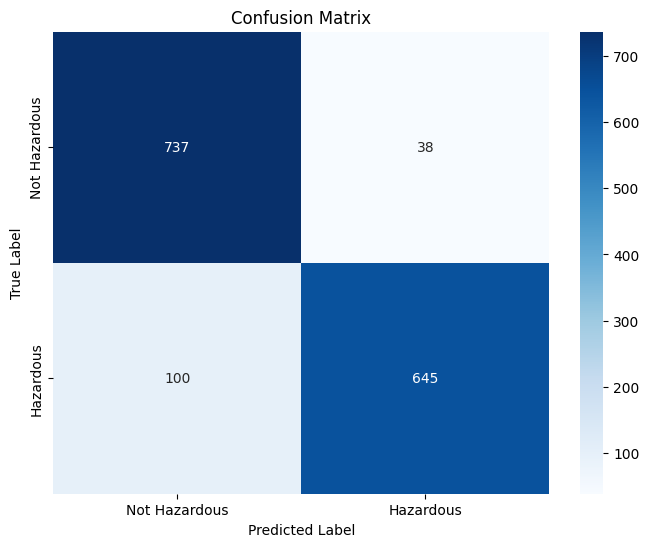

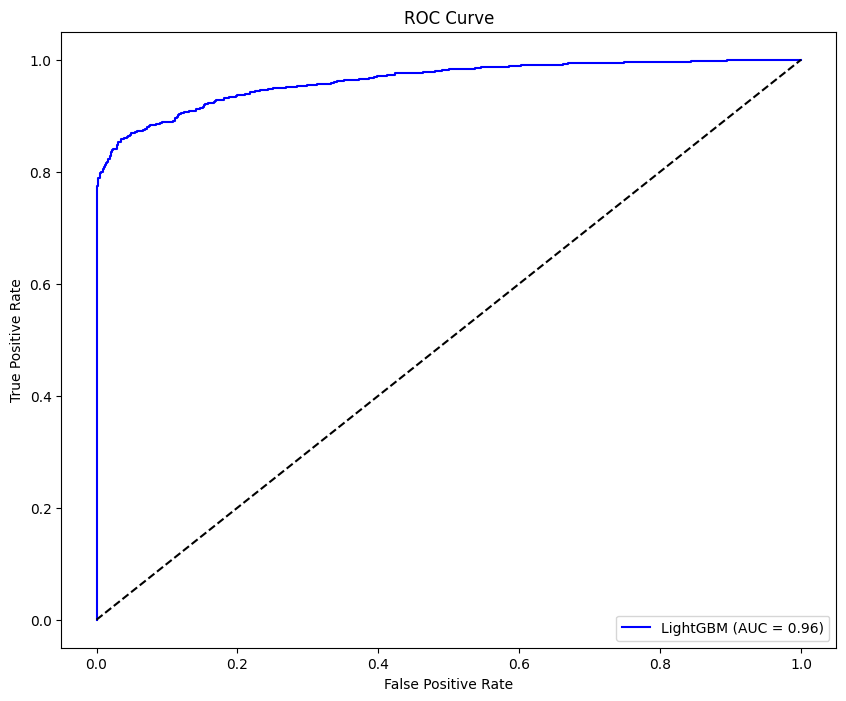

In [29]:
# Import required libraries for model training and evaluation
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve
import lightgbm as lgb
import seaborn as sns
import matplotlib.pyplot as plt

# Initialize the LightGBM model
lgb_model = lgb.LGBMClassifier(random_state=42)

# Train the model on the training set
lgb_model.fit(X_train, y_train)

# Predict on the test set
y_pred = lgb_model.predict(X_test)
y_proba = lgb_model.predict_proba(X_test)[:, 1]

# Evaluate model performance
print("Classification Report:\n", classification_report(y_test, y_pred))

# Confusion Matrix
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Not Hazardous', 'Hazardous'], 
            yticklabels=['Not Hazardous', 'Hazardous'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

# ROC Curve
fpr, tpr, _ = roc_curve(y_test, y_proba)
roc_auc = roc_auc_score(y_test, y_proba)
plt.figure(figsize=(10, 8))
plt.plot(fpr, tpr, color='blue', label=f'LightGBM (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc='lower right')
plt.show()


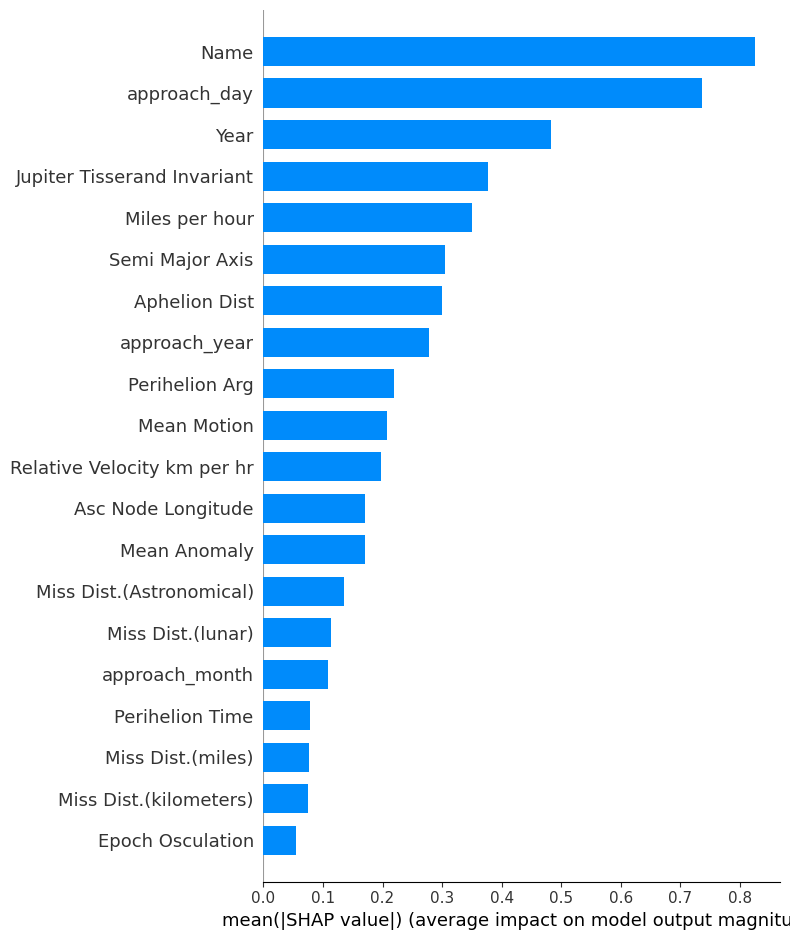

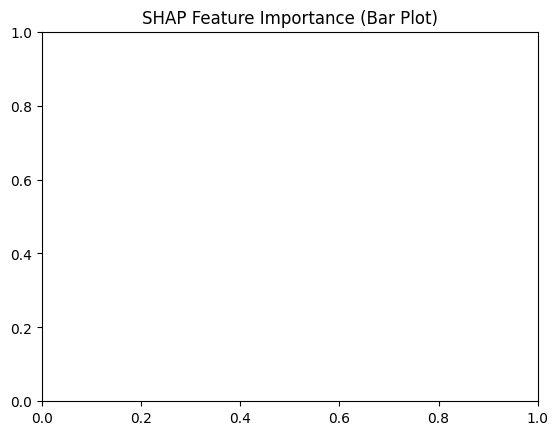

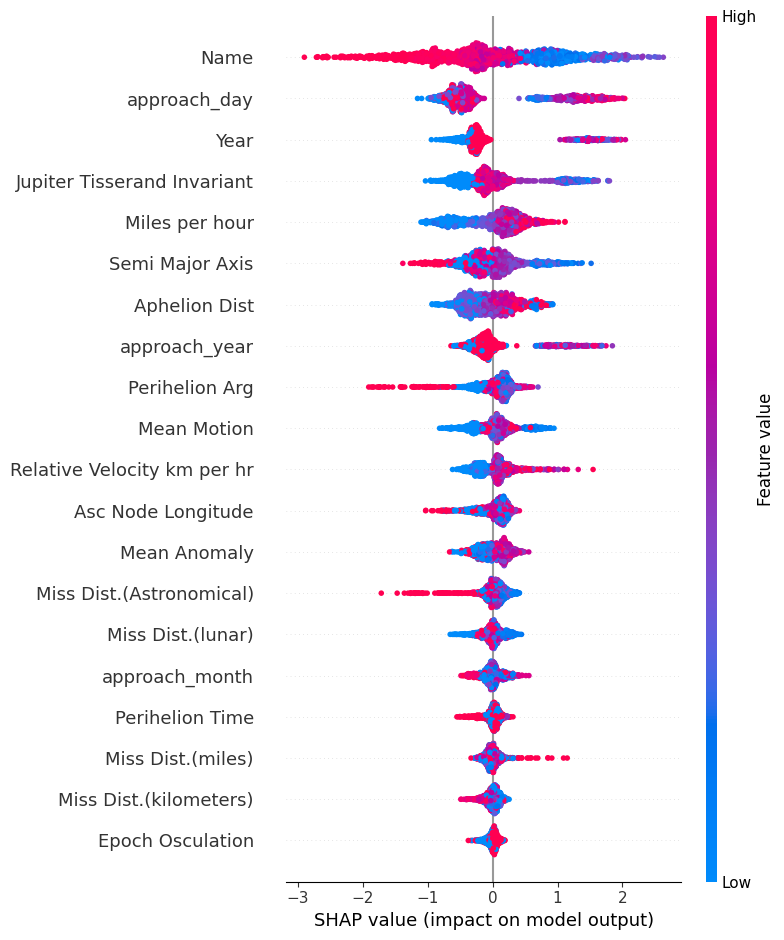

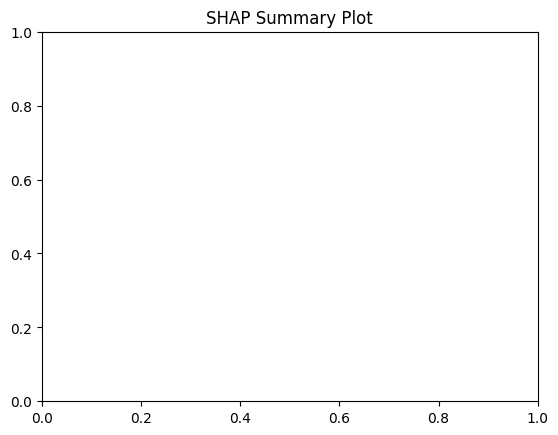

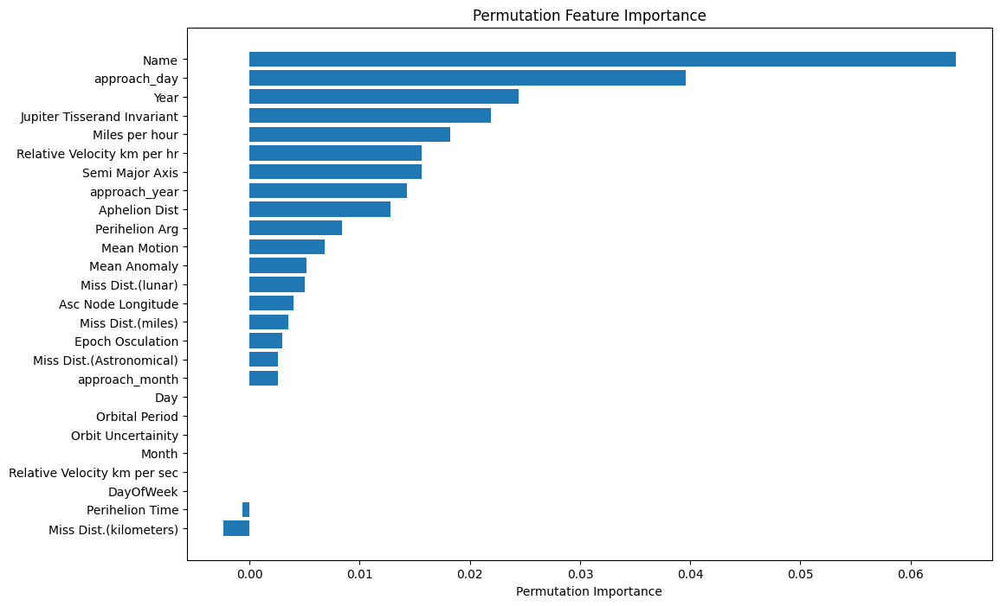

In [32]:
# Check the shape of shap_values to ensure it aligns with the model output
if isinstance(shap_values, list):
    shap_values = shap_values[0]

# Plot SHAP summary plot (bar plot)
plt.figure(figsize=(12, 8))
shap.summary_plot(shap_values, X_test, plot_type="bar")
plt.title("SHAP Feature Importance (Bar Plot)")
plt.show()

# SHAP summary plot for all feature impacts
shap.summary_plot(shap_values, X_test)
plt.title("SHAP Summary Plot")
plt.show()

# Optional: Permutation Importance using scikit-learn
from sklearn.inspection import permutation_importance

# Calculate permutation importance
perm_importance = permutation_importance(lgb_model, X_test, y_test, n_repeats=10, random_state=42)

# Plot Permutation Importance
sorted_idx = perm_importance.importances_mean.argsort()
plt.figure(figsize=(12, 8))
plt.barh(range(len(sorted_idx)), perm_importance.importances_mean[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), X_test.columns[sorted_idx])
plt.xlabel("Permutation Importance")
plt.title("Permutation Feature Importance")
plt.show()


Anomaly counts:
 Anomaly
0    1365
1     155
Name: count, dtype: int64


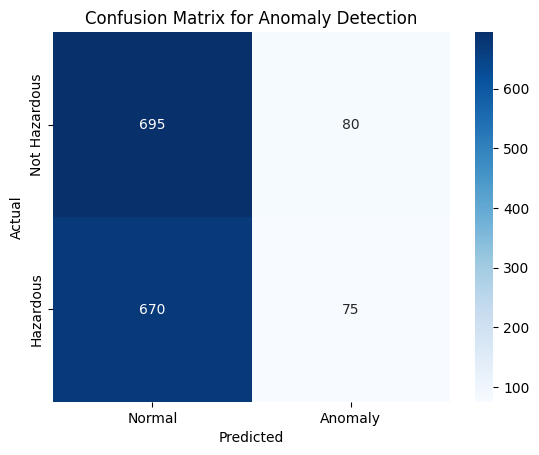

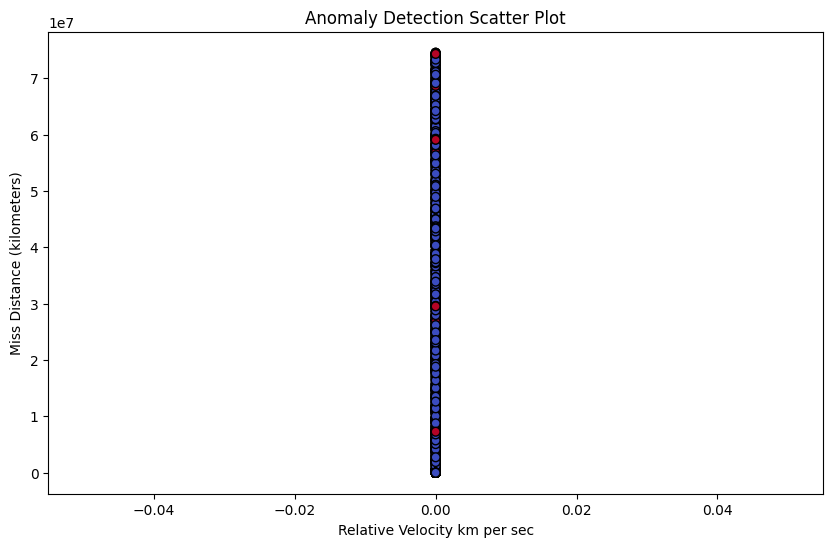

In [33]:
from sklearn.ensemble import IsolationForest
import seaborn as sns
import matplotlib.pyplot as plt

# Define Isolation Forest model
iso_forest = IsolationForest(contamination=0.1, random_state=42)

# Fit model to training data
iso_forest.fit(X_train)

# Predict anomalies on the test set
X_test['Anomaly'] = iso_forest.predict(X_test)

# Convert anomaly predictions: -1 for anomaly and 1 for normal
# Adjusting for ease of interpretation
X_test['Anomaly'] = X_test['Anomaly'].map({-1: 1, 1: 0})

# Count the number of anomalies
anomalies = X_test['Anomaly'].value_counts()
print("Anomaly counts:\n", anomalies)

# Visualize anomalies in a confusion matrix with the Hazardous label
cm_anomaly = confusion_matrix(y_test, X_test['Anomaly'])
sns.heatmap(cm_anomaly, annot=True, fmt="d", cmap="Blues", xticklabels=['Normal', 'Anomaly'], yticklabels=['Not Hazardous', 'Hazardous'])
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix for Anomaly Detection")
plt.show()

# Optional: Scatter plot to visualize anomalies in relation to a few features
plt.figure(figsize=(10, 6))
plt.scatter(X_test['Relative Velocity km per sec'], X_test['Miss Dist.(kilometers)'], c=X_test['Anomaly'], cmap='coolwarm', edgecolors='k', s=40)
plt.xlabel('Relative Velocity km per sec')
plt.ylabel('Miss Distance (kilometers)')
plt.title('Anomaly Detection Scatter Plot')
plt.show()


In [34]:
import joblib

# Define the filename for the model
model_filename = 'asteroid_hazard_model.pkl'

# Save the trained LightGBM model
joblib.dump(lgb_model, model_filename)

print(f"Model saved as {model_filename}")

# Optional: Save the Isolation Forest model as well, if needed for anomaly detection
anomaly_model_filename = 'isolation_forest_model.pkl'
joblib.dump(iso_forest, anomaly_model_filename)
print(f"Anomaly detection model saved as {anomaly_model_filename}")


Model saved as asteroid_hazard_model.pkl
Anomaly detection model saved as isolation_forest_model.pkl


In [38]:
# Load the LightGBM model
lgb_model_loaded = joblib.load(model_filename)
print("LightGBM model loaded successfully.")

# Optional: Load the Isolation Forest model if needed
iso_forest_loaded = joblib.load(anomaly_model_filename)
print("Isolation Forest model loaded successfully.")

LightGBM model loaded successfully.
Isolation Forest model loaded successfully.
